In [1]:
%cd "../.."

/home/id1896/python/2A/projet-statistique-2022


In [2]:
from gensim import models
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
import json
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.cluster import KMeans
from sklearn_extra.cluster import KMedoids
from sklearn.manifold import TSNE

import seaborn as sns
import plotly.express as px


from word_embedding.distance_wmd import *
import doc_embedding.moyenne as moyenne
from reduction_dim.correlation_matrix import *
import clustering.fit_clustering as CL 

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

In [3]:
with open('data/docs.json', encoding = "utf8") as f:
    docs = json.load(f)

dict_moy_embedding = {}
for modele in ["glove","cbow","skipgram"]:
    ev = models.KeyedVectors.load_word2vec_format(f"data/tuning/{modele}.kv")
    #Read moy matrix
    dict_moy_embedding[modele] = {}
    dict_moy_embedding[modele]["TF"] = moyenne.word_emb_vers_doc_emb_moyenne(docs, ev, methode = 'TF')
    dict_moy_embedding[modele]["TFIDF"] = moyenne.word_emb_vers_doc_emb_moyenne(docs, ev, methode = 'TF-IDF')

In [4]:
dict_wmd_embedding = {}
for modele in ["glove","cbow","skipgram"]:
    #Read moy matrix
    dict_wmd_embedding[modele] = {}
    dict_wmd_embedding[modele]["Distance"] = np.array(lecture_fichier_distances_wmd(f"distances_{modele}.7z"))
    if modele != "glove":
        dict_wmd_embedding[modele]["MDS"] = np.array(pd.read_csv(f"data/tuning/MDS/{modele}_mds_embedding.csv",sep=";",header=0))

In [5]:
df_kmeans_clustering = pd.read_csv("data/tunning/clustering/kmeans.csv",sep=";")
df_kmeans_clustering.head()

,K,initialisation,nb_iter,tolerance,val_obj,silhouette,Cal-Harabasz,DBCV,clustering,perplexity,wordEmbedding,docEmbedding,docEmbedding2
0,2,k-means++,10.0,0.0001,1293.257039,0.550733,5672.310806,-0.768834,kmeans,NaN,skipgram,Moyenne,TF
1,2,random,10.0,0.0001,1293.257039,0.550733,5672.310806,-0.768834,kmeans,NaN,skipgram,Moyenne,TF
2,3,k-means++,10.0,0.0001,958.649395,0.294544,5483.281495,-0.871607,kmeans,NaN,skipgram,Moyenne,TF
3,3,random,10.0,0.0001,958.649395,0.294544,5483.281495,-0.871607,kmeans,NaN,skipgram,Moyenne,TF
4,4,k-means++,10.0,0.0001,779.570831,0.294610,5222.015682,-0.827194,kmeans,NaN,skipgram,Moyenne,TF


# Avant Tsne

## Moyenne embedding

In [6]:
df_kmeans_moy = df_kmeans_clustering.loc[(df_kmeans_clustering["docEmbedding"] == "Moyenne") & (df_kmeans_clustering["perplexity"].isna())].reset_index()

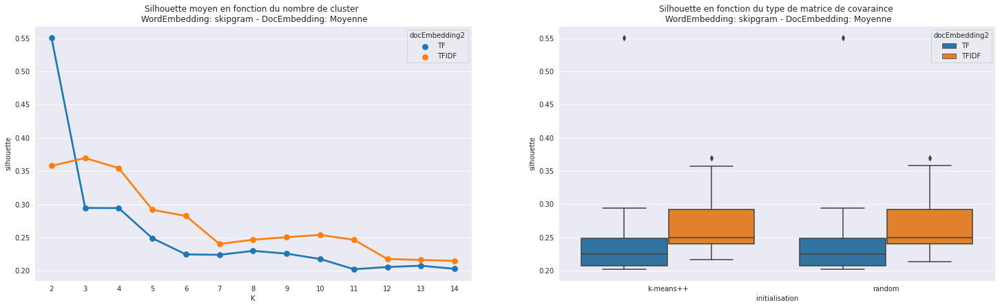

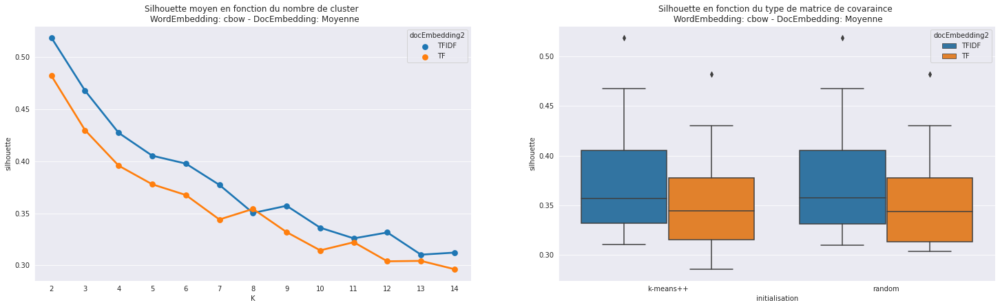

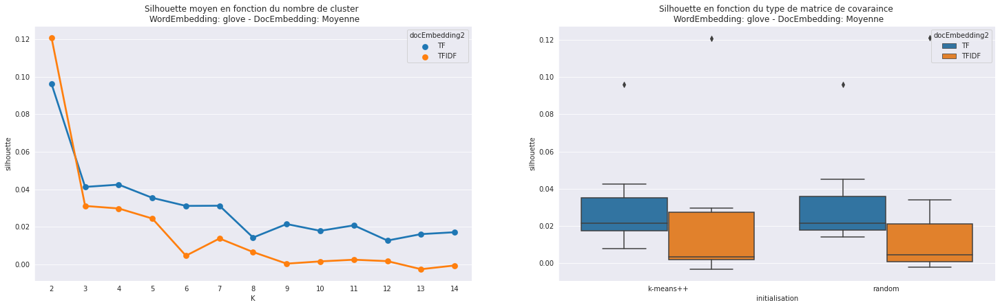

In [7]:
sns.set_style("darkgrid")
for modele in ["skipgram","cbow","glove"]:
    plt.figure(figsize = (25,15))
    sns.pointplot(data=df_kmeans_moy[df_kmeans_moy["wordEmbedding"]==modele],y="silhouette",x="K",hue="docEmbedding2",ci=None,
        ax=plt.subplot(2,2,1,title=f"Silhouette moyen en fonction du nombre de cluster \n WordEmbedding: {modele} - DocEmbedding: Moyenne"))
    # sns.boxplot(data = df_kmeans_moy[df_kmeans_moy["wordEmbedding"]==modele],y="silhouette",x="K",hue="docEmbedding2",ax=plt.subplot(2,2,1,title="K"))

    sns.boxplot(data=df_kmeans_moy[df_kmeans_moy["wordEmbedding"]==modele],y="silhouette",x="initialisation",hue="docEmbedding2",
        ax=plt.subplot(2,2,2,title=f"Silhouette en fonction du type de matrice de covaraince \n WordEmbedding: {modele} - DocEmbedding: Moyenne"))
    # sns.boxplot(data=df_kmeans_moyTF,y="silhouette",x="initialisation",hue="wordEmbedding",ax=plt.subplot(2,2,2,title="initialisation"))
    plt.show()

In [8]:
df_kmeans_moy.loc[df_kmeans_moy.groupby(["wordEmbedding"])["silhouette"].idxmax()]

,index,K,initialisation,nb_iter,tolerance,val_obj,silhouette,Cal-Harabasz,DBCV,clustering,perplexity,wordEmbedding,docEmbedding,docEmbedding2
43,199,2,random,10.0,0.0001,1183.081300,0.518736,14238.411443,-0.789848,kmeans,NaN,cbow,Moyenne,TFIDF
104,1118,2,random,10.0,0.0001,0.461005,0.121071,144.477072,-0.614859,kmeans,NaN,glove,Moyenne,TFIDF
0,0,2,k-means++,10.0,0.0001,1293.257039,0.550733,5672.310806,-0.768834,kmeans,NaN,skipgram,Moyenne,TF


## WMD

In [9]:
df_kmeans_wmd = df_kmeans_clustering.loc[(df_kmeans_clustering["docEmbedding"] == "WMD") & (df_kmeans_clustering["perplexity"].isna())].reset_index()

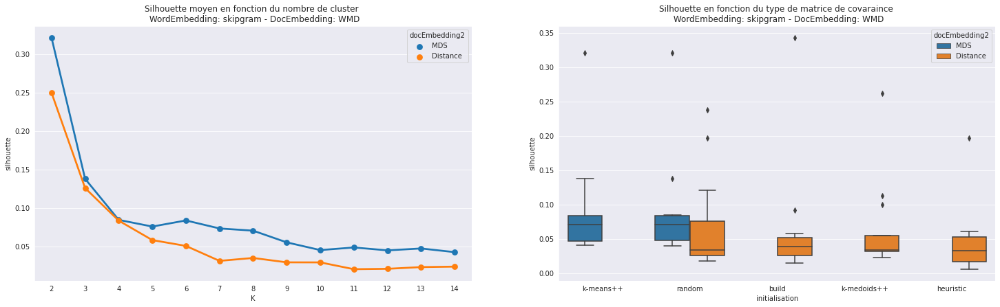

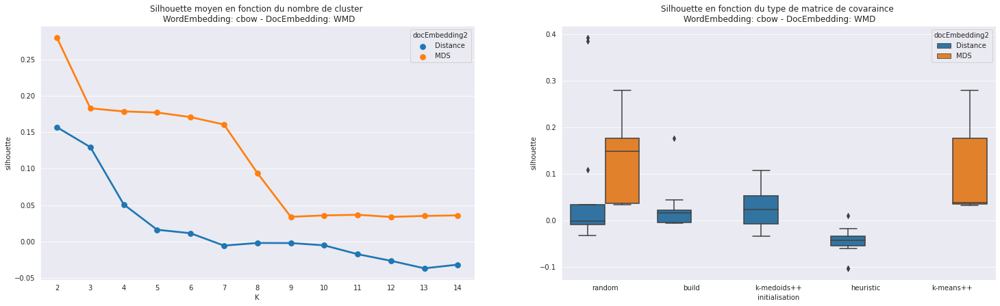

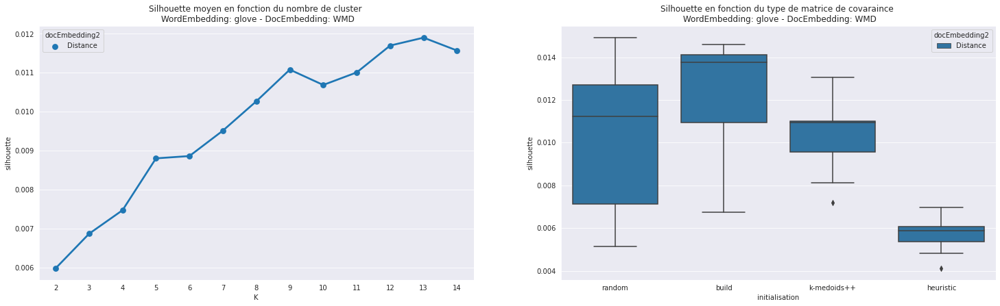

In [10]:
sns.set_style("darkgrid")
for modele in ["skipgram","cbow","glove"]:
    plt.figure(figsize = (25,15))
    sns.pointplot(data=df_kmeans_wmd[df_kmeans_wmd["wordEmbedding"]==modele],y="silhouette",x="K",hue="docEmbedding2",ci=None,
        ax=plt.subplot(2,2,1,title=f"Silhouette moyen en fonction du nombre de cluster \n WordEmbedding: {modele} - DocEmbedding: WMD"))
    # sns.boxplot(data = df_kmeans_moy[df_kmeans_moy["wordEmbedding"]==modele],y="silhouette",x="K",hue="docEmbedding2",ax=plt.subplot(2,2,1,title="K"))

    sns.boxplot(data=df_kmeans_wmd[df_kmeans_wmd["wordEmbedding"]==modele],y="silhouette",x="initialisation",hue="docEmbedding2",
        ax=plt.subplot(2,2,2,title=f"Silhouette en fonction du type de matrice de covaraince \n WordEmbedding: {modele} - DocEmbedding: WMD"))
    # sns.boxplot(data=df_kmeans_moyTF,y="silhouette",x="initialisation",hue="wordEmbedding",ax=plt.subplot(2,2,2,title="initialisation"))
    plt.show()

In [11]:
df_kmeans_wmd.loc[df_kmeans_wmd.groupby(["wordEmbedding","docEmbedding2"])["silhouette"].idxmax()]

,index,K,initialisation,nb_iter,tolerance,val_obj,silhouette,Cal-Harabasz,DBCV,clustering,perplexity,wordEmbedding,docEmbedding,docEmbedding2
0,364,2,random,NaN,NaN,1.854196e+06,0.393266,NaN,-0.582591,kmedoides,NaN,cbow,WMD,Distance
131,1691,2,random,10.0,0.0001,3.888807e+08,0.280042,1208.093956,-0.612498,kmeans,NaN,cbow,WMD,MDS
156,1872,12,random,NaN,NaN,1.142444e+07,0.014913,NaN,NaN,kmedoides,NaN,glove,WMD,Distance
78,1482,2,build,NaN,NaN,1.983063e+06,0.342656,NaN,-0.894603,kmedoides,NaN,skipgram,WMD,Distance
52,754,2,k-means++,10.0,0.0001,3.936005e+08,0.321155,2623.537959,-0.715851,kmeans,NaN,skipgram,WMD,MDS


# Avec TSNE

## Moyenne

In [12]:
df_kmeans_moy2 = df_kmeans_clustering.loc[(df_kmeans_clustering["docEmbedding"] == "Moyenne") & (df_kmeans_clustering["perplexity"].notna())].reset_index()

In [13]:
df_kmeans_moy2.loc[df_kmeans_moy2.groupby(["wordEmbedding","docEmbedding"])["silhouette"].idxmax()]

,index,K,initialisation,nb_iter,tolerance,val_obj,silhouette,Cal-Harabasz,DBCV,clustering,perplexity,wordEmbedding,docEmbedding,docEmbedding2
308,360,3,k-means++,10.0,0.0001,2196685.50,0.509497,14295.322045,-0.663063,kmeans,200.0,cbow,Moyenne,TFIDF
415,701,2,k-means++,10.0,0.0001,2220466.00,0.376849,7089.565986,-0.874257,kmeans,125.0,glove,Moyenne,TF
620,1114,2,random,10.0,0.0001,2966657.75,0.491937,13133.571780,-0.757427,kmeans,200.0,skipgram,Moyenne,TFIDF


## WMD

In [14]:
df_kmeans_wmd2 = df_kmeans_clustering.loc[(df_kmeans_clustering["docEmbedding"] == "WMD") & (df_kmeans_clustering["perplexity"].notna())].reset_index()

In [15]:
df_kmeans_wmd2.loc[df_kmeans_wmd2.groupby(["wordEmbedding","docEmbedding"])["silhouette"].idxmax()]

,index,K,initialisation,nb_iter,tolerance,val_obj,silhouette,Cal-Harabasz,DBCV,clustering,perplexity,wordEmbedding,docEmbedding,docEmbedding2
46,462,3,k-means++,10.0,0.0001,5609326.000,0.420430,8974.114765,-0.858434,kmeans,75.0,cbow,WMD,Distance
776,2076,3,k-means++,10.0,0.0001,1957373.375,0.395142,8052.595624,-0.847480,kmeans,200.0,glove,WMD,Distance
209,833,2,k-means++,10.0,0.0001,2546803.250,0.467745,12305.542778,-0.753853,kmeans,100.0,skipgram,WMD,MDS


# Plot ScatterPlot

In [16]:
def plot_kmeans(df_kmeans,dict_embedding,kmeans_metric="silhouette",first_reduce=False,modele="cbow",typeDocEmbedding = "Moyenne"):
    best_model = df_kmeans.loc[df_kmeans.groupby(["wordEmbedding"])[kmeans_metric].idxmin()] if kmeans_metric == "BIC" else df_kmeans.loc[df_kmeans.groupby(["wordEmbedding"])[kmeans_metric].idxmax()]
    best_model = best_model[best_model["wordEmbedding"]==modele]

    if len(best_model) > 0:
        tsne_metric = "precomputed" if best_model["docEmbedding2"].values[0] == "Distance" else "euclidean"


        doc_embedding = dict_embedding[modele]

        tsne = TSNE(n_components = 2, perplexity=200, n_iter=2000, random_state=0,metric=tsne_metric)

        tsne_embedding = tsne.fit_transform(doc_embedding[best_model["docEmbedding2"].values[0]])

        if best_model["clustering"].values[0] == "kmeans":
            clust_model = KMeans(n_clusters = best_model["K"].values[0], init = best_model["initialisation"].values[0])
        else:
            clust_model = KMedoids(n_clusters = best_model["K"].values[0], init = best_model["initialisation"].values[0], metric = 'precomputed')
        
        kmeans_data = tsne_embedding if first_reduce else doc_embedding[best_model["docEmbedding2"].values[0]]
        labels = clust_model.fit_predict(kmeans_data)

        color_palette = sns.color_palette('Paired', len(np.unique(labels)))
        cluster_colors = [color_palette[x] if x >= 0 else (0.5, 0.5, 0.5) for x in labels]

        title = f"Best {typeDocEmbedding} DocEmbedding kmeans Clustering based on {kmeans_metric}"
        subtitle1 = f"WordEmbedding: {modele} - DocEmbedding: {best_model['docEmbedding'].values[0]} {best_model['docEmbedding2'].values[0]} - Reduced Before Clustering: {first_reduce}" 
        subtitle2 = f"Number of cluster: {len(np.unique(labels))} - Silhouette: {round(best_model['silhouette'].values[0],2)}"
        title=f"{title}\n{subtitle1}\n{subtitle2}"


        return labels,tsne_embedding, cluster_colors, title
    else: 
        return [None, None,None,None]

## WMD Embedding

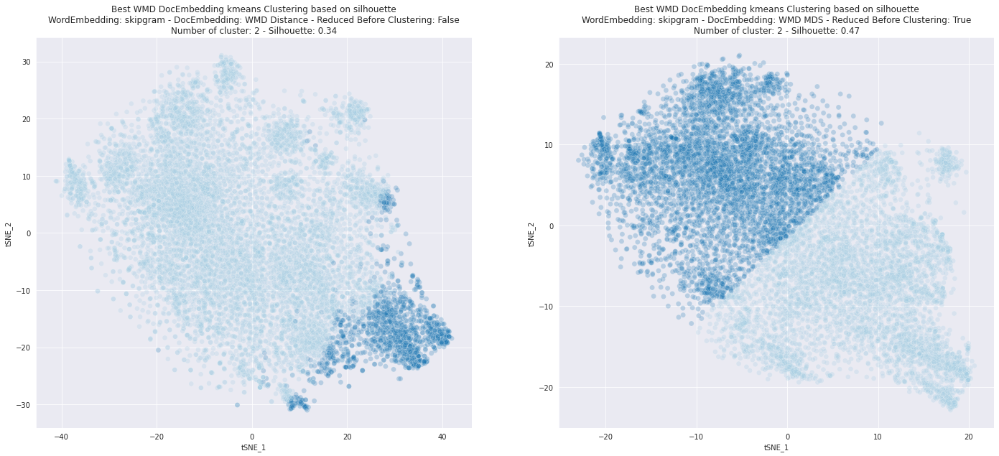

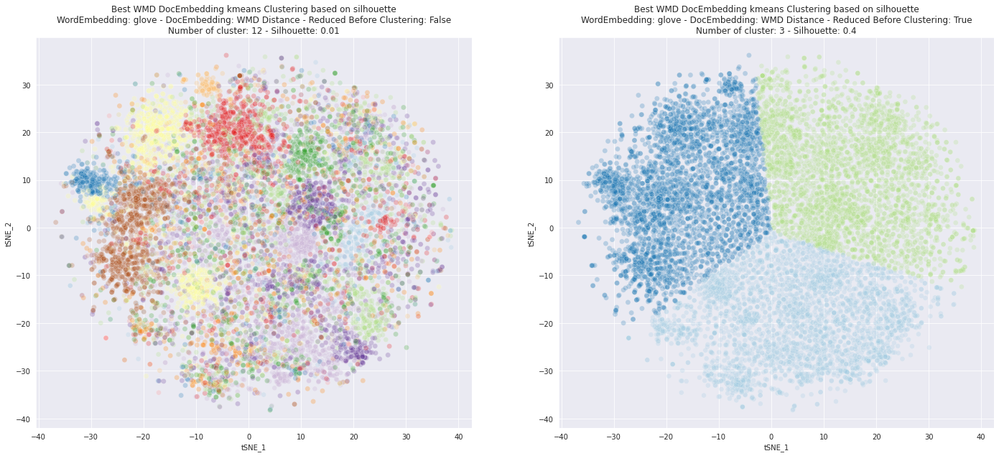

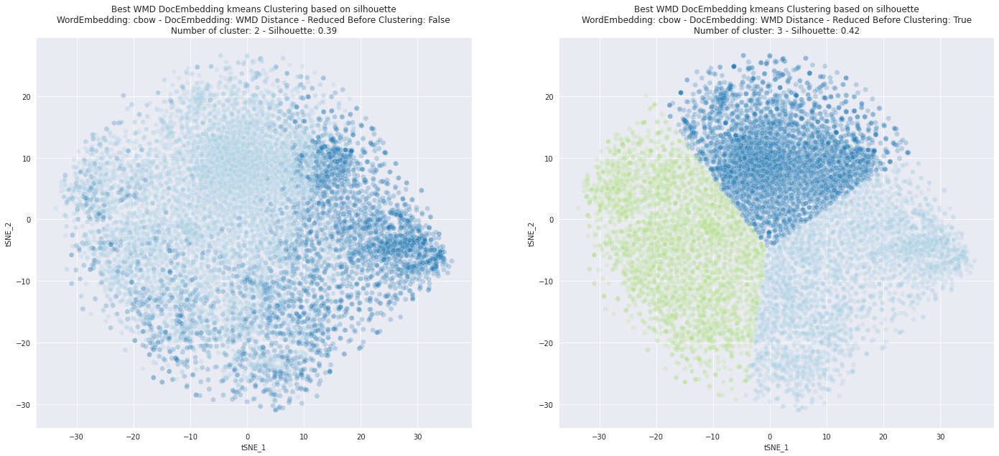

In [17]:
for modele in ["skipgram","glove","cbow"]:
    #Silhouette
    labels_silhouette, tsne_wmd_silhouette, silhouette_colors, silhouette_title = plot_kmeans(df_kmeans_wmd,dict_wmd_embedding,kmeans_metric="silhouette",first_reduce=False,modele=modele,typeDocEmbedding="WMD")
    labels_silhouette2, tsne_wmd_silhouette2, silhouette_colors2, silhouette_title2 = plot_kmeans(df_kmeans_wmd2,dict_wmd_embedding,kmeans_metric="silhouette",first_reduce=True,modele=modele,typeDocEmbedding = "WMD")

    #Plot
    plt.figure(figsize = (50,10))
    if silhouette_title is not None:
        sns.scatterplot(tsne_wmd_silhouette[:,0],tsne_wmd_silhouette[:,1], s=50, c=silhouette_colors, alpha=0.25,ax=plt.subplot(1,4,3,title=silhouette_title))
        plt.xlabel("tSNE_1")
        plt.ylabel("tSNE_2")
    sns.scatterplot(tsne_wmd_silhouette2[:,0],tsne_wmd_silhouette2[:,1], s=50, c=silhouette_colors2, alpha=0.25,ax=plt.subplot(1,4,4,title=silhouette_title2))
    plt.xlabel("tSNE_1")
    plt.ylabel("tSNE_2")
    plt.show()

## Moyenne Embedding

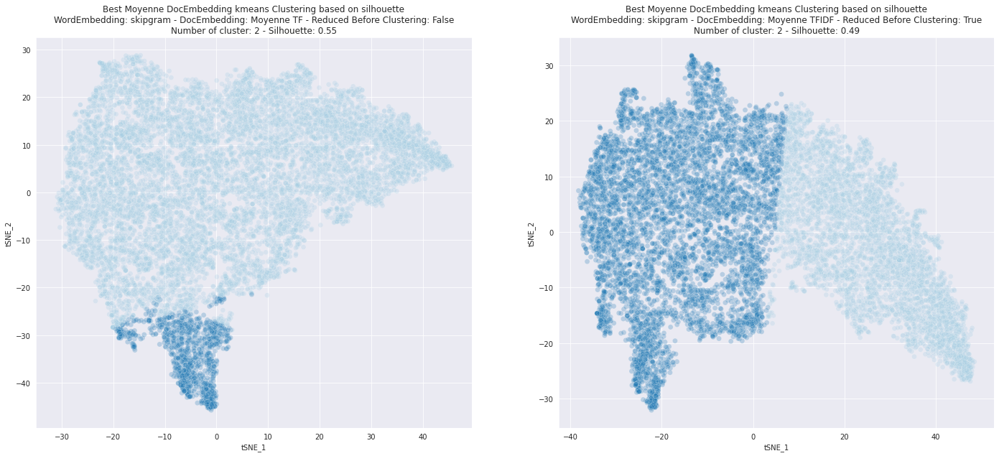

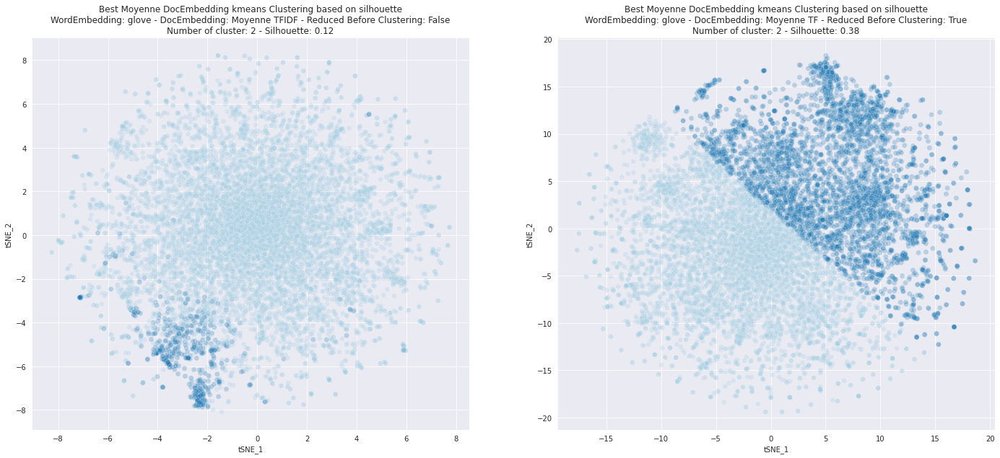

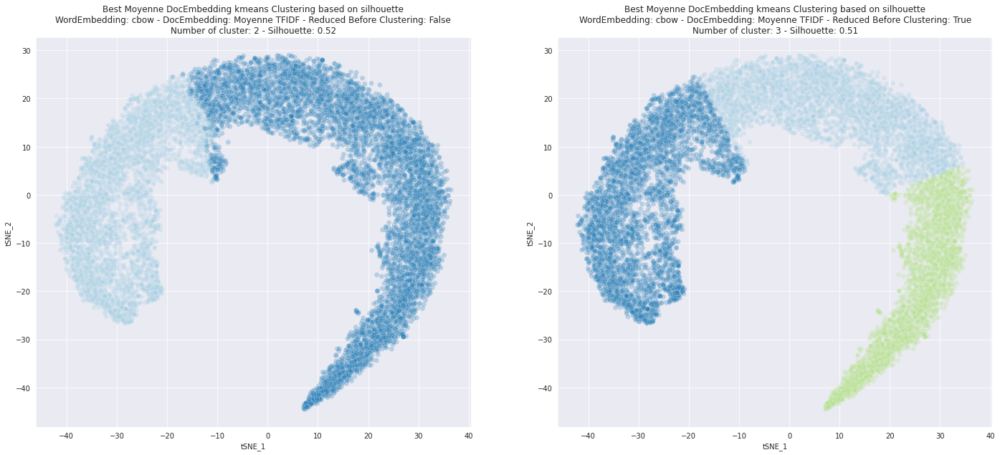

In [18]:
for modele in ["skipgram","glove","cbow"]:
    #Silhouette
    labels_silhouette, tsne_wmd_silhouette, silhouette_colors, silhouette_title = plot_kmeans(df_kmeans_moy,dict_moy_embedding,kmeans_metric="silhouette",first_reduce=False,modele=modele)
    labels_silhouette2, tsne_wmd_silhouette2, silhouette_colors2, silhouette_title2 = plot_kmeans(df_kmeans_moy2,dict_moy_embedding,kmeans_metric="silhouette",first_reduce=True,modele=modele)

    #Plot
    plt.figure(figsize = (50,10))
    if silhouette_title is not None:
        sns.scatterplot(tsne_wmd_silhouette[:,0],tsne_wmd_silhouette[:,1], s=50, c=silhouette_colors, alpha=0.25,ax=plt.subplot(1,4,3,title=silhouette_title))
        plt.xlabel("tSNE_1")
        plt.ylabel("tSNE_2")
    sns.scatterplot(tsne_wmd_silhouette2[:,0],tsne_wmd_silhouette2[:,1], s=50, c=silhouette_colors2, alpha=0.25,ax=plt.subplot(1,4,4,title=silhouette_title2))
    plt.xlabel("tSNE_1")
    plt.ylabel("tSNE_2")

    plt.show()